In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode()

from sklearn import model_selection
from sklearn import metrics, ensemble, linear_model
import xgboost as xgb
import catboost as cb
import lightgbm as lgb
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import HistGradientBoostingRegressor
import warnings
warnings.filterwarnings('ignore') 

In [2]:
features = pd.read_csv('../input/walmart-recruiting-store-sales-forecasting/features.csv.zip')
train = pd.read_csv('../input/walmart-recruiting-store-sales-forecasting/train.csv.zip')
stores = pd.read_csv('../input/walmart-recruiting-store-sales-forecasting/stores.csv')
test = pd.read_csv('../input/walmart-recruiting-store-sales-forecasting/test.csv.zip')
sample_submission = pd.read_csv('../input/walmart-recruiting-store-sales-forecasting/sampleSubmission.csv.zip')

In [3]:
feature_store = features.merge(stores, how='inner', on = "Store")

In [4]:
train_df = train.merge(feature_store, how='inner', on = ['Store','Date','IsHoliday']).sort_values(by=['Store','Dept','Date']).reset_index(drop=True)

In [5]:
test_df = test.merge(feature_store, how='inner', on = ['Store','Date','IsHoliday']).sort_values(by = ['Store','Dept','Date']).reset_index(drop=True)

In [6]:
train_df.describe().T.style.bar(subset=['mean'], color='#205ff2')\
                            .background_gradient(subset=['std'], cmap='Reds')\
                            .background_gradient(subset=['50%'], cmap='coolwarm')

,count,mean,std,min,25%,50%,75%,max
Store,421570.000000,22.200546,12.785297,1.000000,11.000000,22.000000,33.000000,45.000000
Dept,421570.000000,44.260317,30.492054,1.000000,18.000000,37.000000,74.000000,99.000000
Weekly_Sales,421570.000000,15981.258123,22711.183519,-4988.940000,2079.650000,7612.030000,20205.852500,693099.360000
Temperature,421570.000000,60.090059,18.447931,-2.060000,46.680000,62.090000,74.280000,100.140000
Fuel_Price,421570.000000,3.361027,0.458515,2.472000,2.933000,3.452000,3.738000,4.468000
MarkDown1,150681.000000,7246.420196,8291.221345,0.270000,2240.270000,5347.450000,9210.900000,88646.760000
MarkDown2,111248.000000,3334.628621,9475.357325,-265.760000,41.600000,192.000000,1926.940000,104519.540000
MarkDown3,137091.000000,1439.421384,9623.078290,-29.100000,5.080000,24.600000,103.990000,141630.610000
MarkDown4,134967.000000,3383.168256,6292.384031,0.220000,504.220000,1481.310000,3595.040000,67474.850000
MarkDown5,151432.000000,4628.975079,5962.887455,135.160000,1878.440000,3359.450000,5563.800000,108519.280000


In [7]:
feature_store = features.merge(stores, how='inner', on = "Store")

# Converting date column to datetime 
feature_store['Date'] = pd.to_datetime(feature_store['Date'])
train['Date'] = pd.to_datetime(train['Date'])
test['Date'] = pd.to_datetime(test['Date'])

# Adding some basic datetime features
feature_store['Day'] = feature_store['Date'].dt.day
feature_store['Week'] = feature_store['Date'].dt.week
feature_store['Month'] = feature_store['Date'].dt.month
feature_store['Year'] = feature_store['Date'].dt.year

In [8]:
train_df = train.merge(feature_store, how='inner', on = ['Store','Date','IsHoliday']).sort_values(by=['Store','Dept','Date']).reset_index(drop=True)

In [9]:
test_df = test.merge(feature_store, how='inner', on = ['Store','Date','IsHoliday']).sort_values(by = ['Store','Dept','Date']).reset_index(drop=True)

In [10]:
df_weeks = train_df.groupby('Week').sum()

In [11]:
palette = px.colors.qualitative.Safe

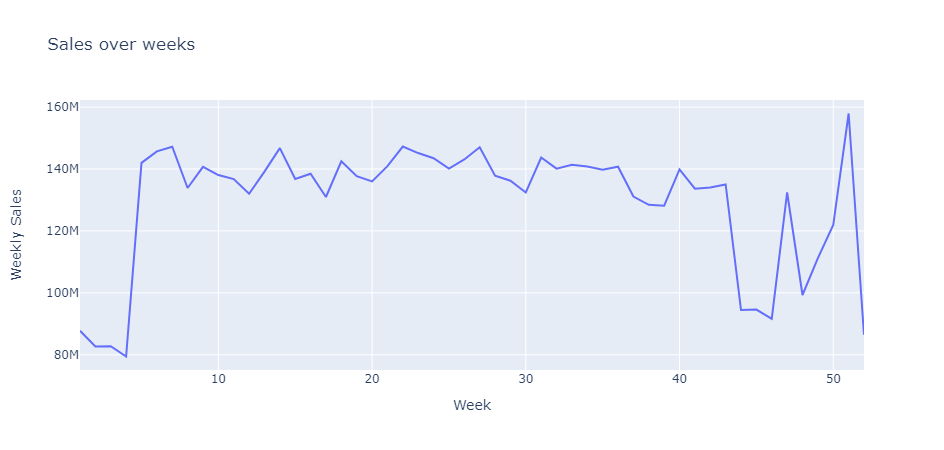

In [12]:
px.line( data_frame = df_weeks, x = df_weeks.index, y = 'Weekly_Sales', 
        labels = {'Weekly_Sales' : 'Weekly Sales', 'x' : 'Weeks' }, 
        title = 'Sales over weeks')

<p style="font-size:20px; font-family:verdana; line-height: 1.7em; margin-left:20px">
<b> Markdowns relationship with sales </b></p>

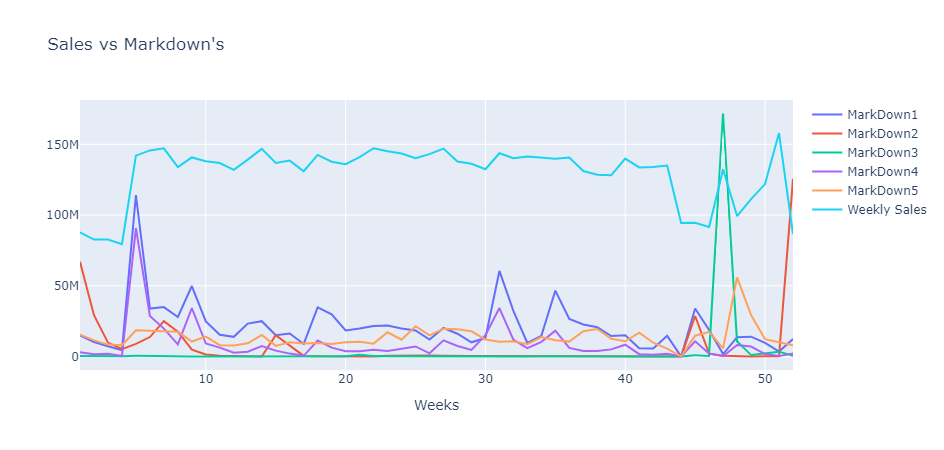

In [13]:
fig = go.Figure()
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown1'], name = 'MarkDown1', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown2'], name = 'MarkDown2', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown3'], name = 'MarkDown3', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown4'], name = 'MarkDown4', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown5'], name = 'MarkDown5', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['Weekly_Sales'], name = 'Weekly Sales', mode = 'lines') )
fig.update_layout(title = "Sales vs Markdown's", xaxis_title = 'Weeks')

<p style="font-size:20px; font-family:verdana; line-height: 1.7em; margin-left:20px">
<b> Mean sales comparassion across the years
         </b></p>

In [14]:
weekly_sales = train_df.groupby(['Year','Week'], as_index = False).agg({'Weekly_Sales': ['mean', 'median']})
weekly_sales2010 = train_df.loc[train_df['Year']==2010].groupby(['Week']).agg({'Weekly_Sales': ['mean', 'median']})
weekly_sales2011 = train_df.loc[train_df['Year']==2011].groupby(['Week']).agg({'Weekly_Sales': ['mean', 'median']})
weekly_sales2012 = train_df.loc[train_df['Year']==2012].groupby(['Week']).agg({'Weekly_Sales': ['mean', 'median']})

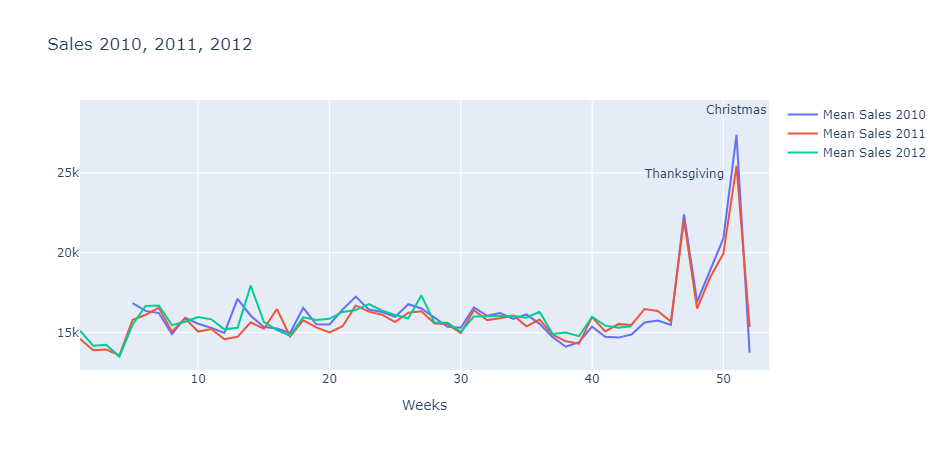

In [15]:
fig = go.Figure()
fig.add_trace(go.Scatter( x = weekly_sales2010['Weekly_Sales']['mean'].index, y = weekly_sales2010['Weekly_Sales']['mean'], name = 'Mean Sales 2010', mode = 'lines') )
fig.add_trace(go.Scatter( x = weekly_sales2011['Weekly_Sales']['mean'].index, y = weekly_sales2011['Weekly_Sales']['mean'], name = 'Mean Sales 2011', mode = 'lines') )
fig.add_trace(go.Scatter( x = weekly_sales2012['Weekly_Sales']['mean'].index, y = weekly_sales2012['Weekly_Sales']['mean'], name = 'Mean Sales 2012', mode = 'lines') )
fig.add_annotation(text="Thanksgiving", x=47, y=25000, showarrow=False)
fig.add_annotation(text="Christmas", x=51, y=29000, showarrow=False)
fig.update_layout(title = 'Sales 2010, 2011, 2012', xaxis_title = 'Weeks')

In [16]:
# we can see that by christmas you have a considerable spike in sales and also a small jump during thanksgiving

In [17]:
# Converting the temperature to celsius for a better interpretation
train_df['Temperature'] = train_df['Temperature'].apply(lambda x :  (x - 32) / 1.8)
train_df['Temperature'] = train_df['Temperature'].apply(lambda x :  (x - 32) / 1.8)

In [18]:
train_plt = train_df.sample(frac=0.20)

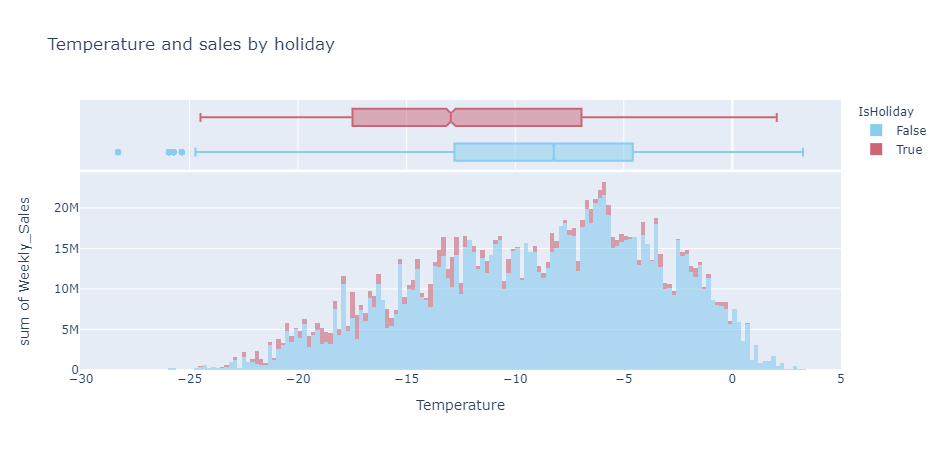

In [19]:
px.histogram(train_plt, x='Temperature', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title = 'Temperature and sales by holiday', color_discrete_sequence=palette)

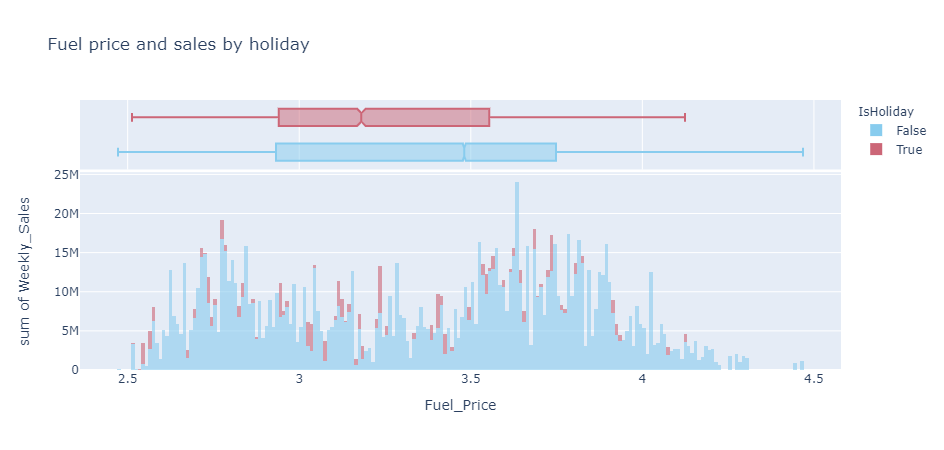

In [20]:
px.histogram(train_plt, x='Fuel_Price', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title='Fuel price and sales by holiday',color_discrete_sequence=palette)

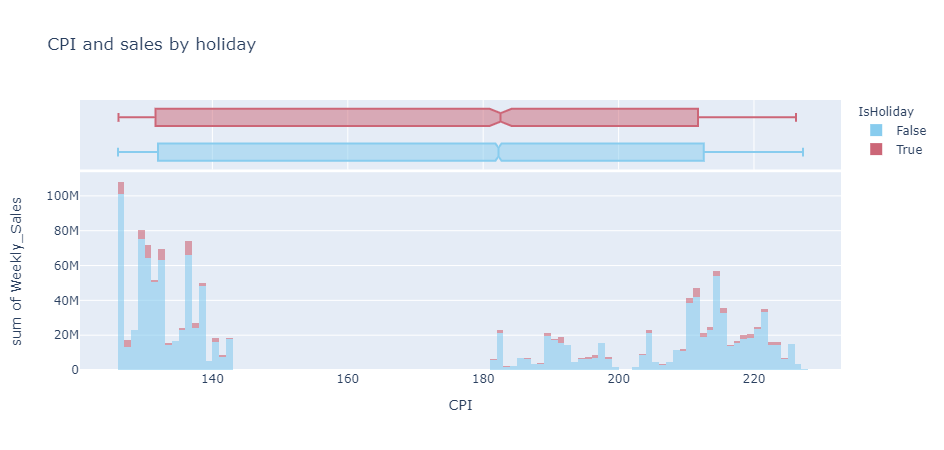

In [21]:
px.histogram(train_plt, x='CPI', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title='CPI and sales by holiday',color_discrete_sequence=palette)

In [22]:
''' CPI is consumer price index (CPI) is the instrument to measure inflation. It is used to estimate the 
average variation between two given periods in the prices of products consumed by households. The pattern here is
not clear but you can see there are three groups and despite rise is CPI the sales are not disappearing'''

' CPI is consumer price index (CPI) is the instrument to measure inflation. It is used to estimate the \naverage variation between two given periods in the prices of products consumed by households. The pattern here is\nnot clear but you can see there are three groups and despite rise is CPI the sales are not disappearing'

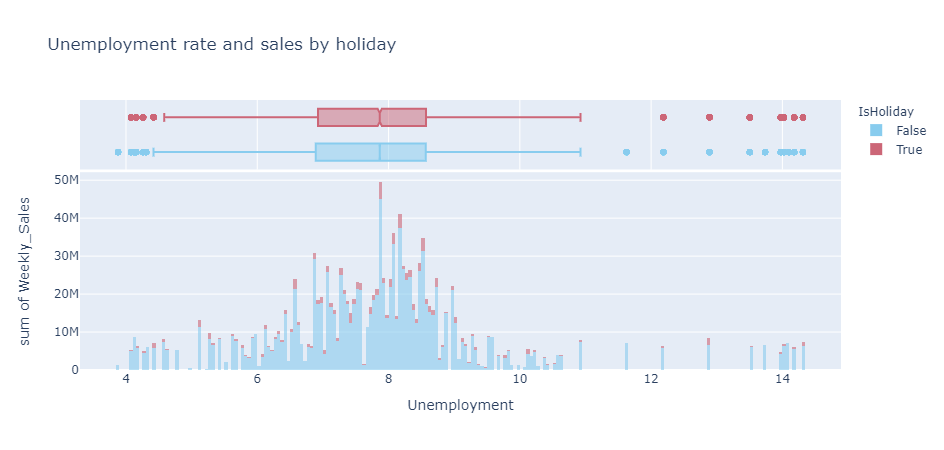

In [23]:
px.histogram(train_plt, x='Unemployment', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title='Unemployment rate and sales by holiday',color_discrete_sequence=palette)

In [24]:
#When considering unemployment, it is clear that high rate of unemployment has negative effects on sales

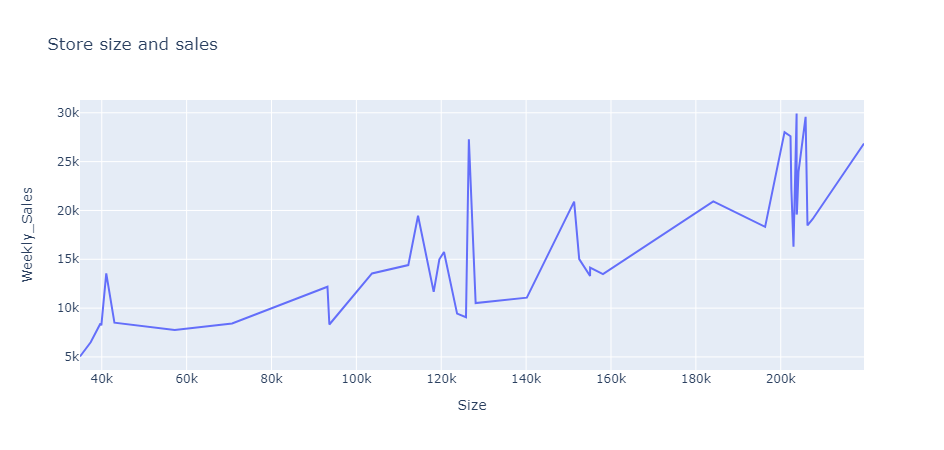

In [25]:
sizes= train_plt.groupby('Size').mean()
px.line(sizes, x = sizes.index, y = sizes.Weekly_Sales, 
        title='Store size and sales')

In [26]:
#Store size seems to be an important factor when it comes to sales.

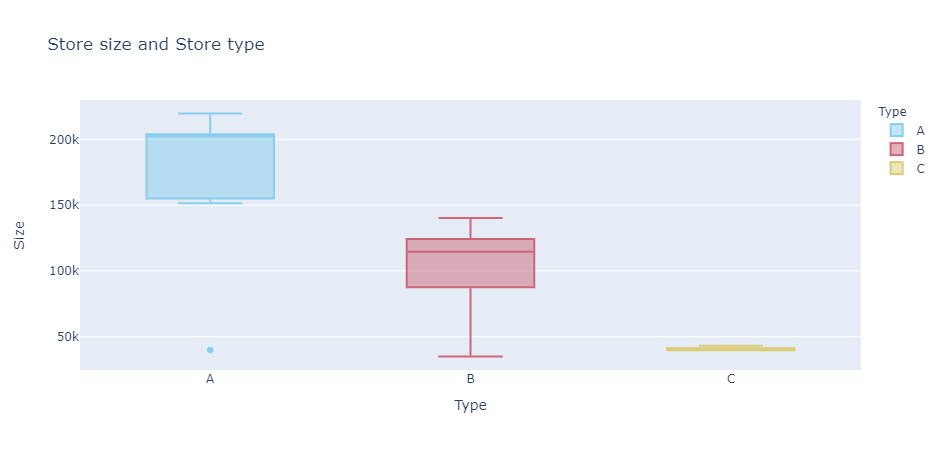

In [27]:
store_type = pd.concat([stores['Type'], stores['Size']], axis=1)
px.box(store_type, x='Type', y='Size', color='Type', 
       title='Store size and Store type',color_discrete_sequence=palette)

In [28]:
#With store sizes there seem to be three main categories

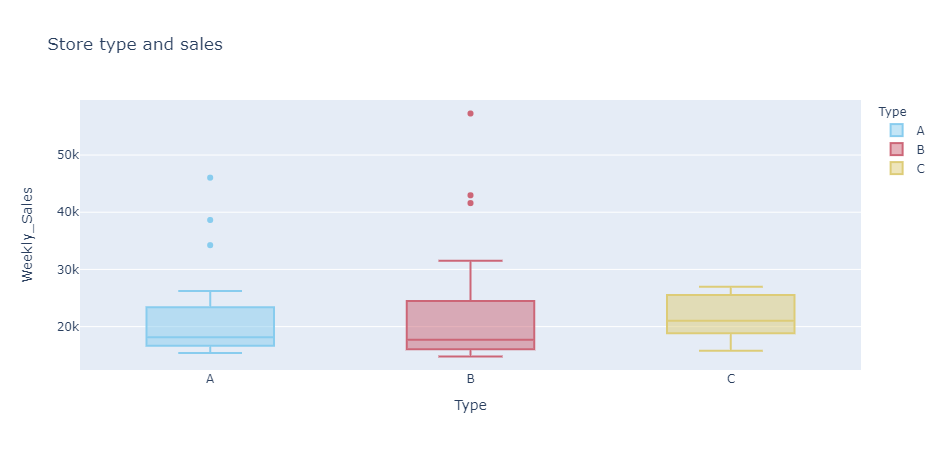

In [29]:
store_sale = pd.concat([stores['Type'], train_df['Weekly_Sales']], axis=1)
px.box(store_sale.dropna(), x='Type', y='Weekly_Sales', color='Type', 
       title='Store type and sales',color_discrete_sequence=palette)

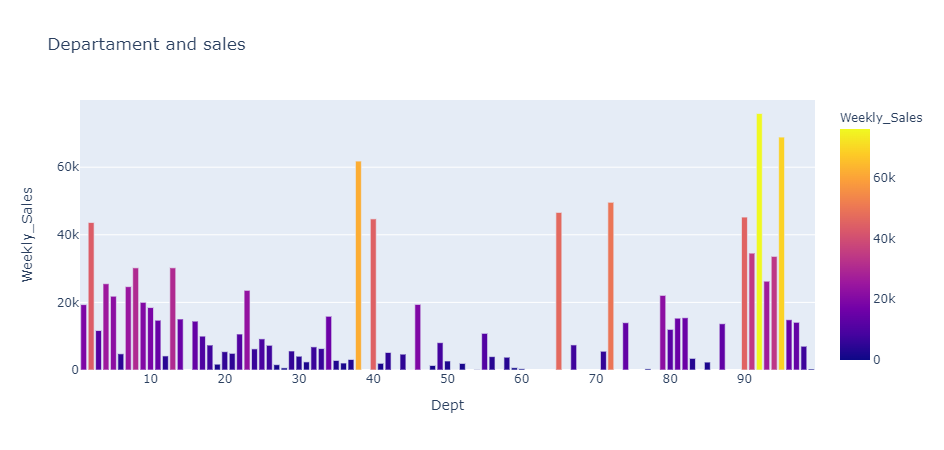

In [30]:
depts= train_plt.groupby('Dept').mean().sort_values(by='Weekly_Sales', ascending='False')
bar=px.bar(depts, x = depts.index, y =  depts.Weekly_Sales, title='Departament and sales',color=depts.Weekly_Sales)
bar.update_layout(barmode='group', xaxis={'categoryorder':'total descending'})

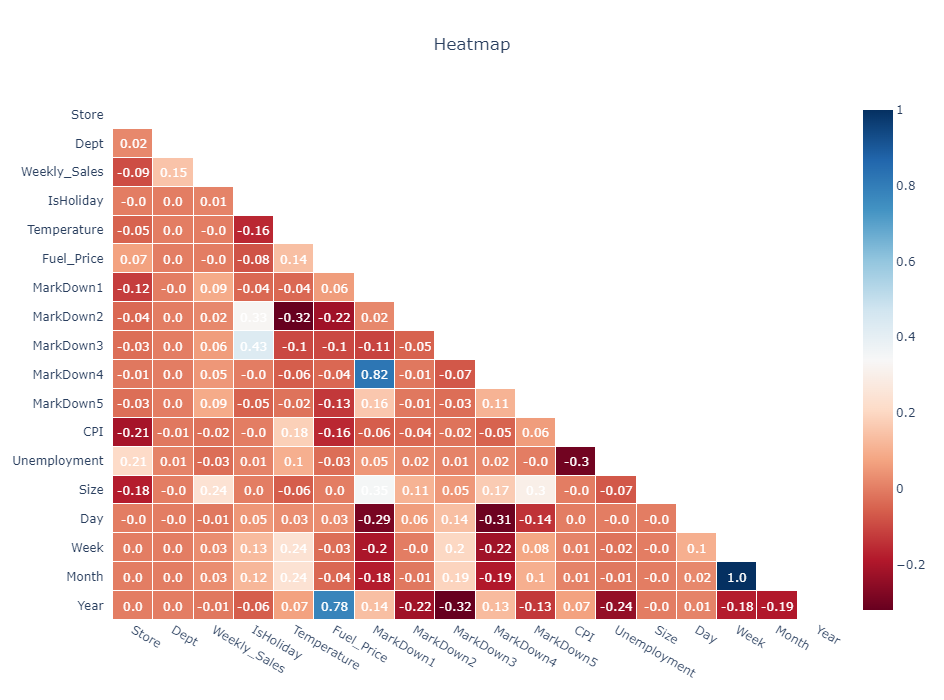

In [31]:
corr = train_df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
df_mask = corr.mask(mask).round(2)

fig = ff.create_annotated_heatmap(z=df_mask.to_numpy(), 
                                  x=df_mask.columns.tolist(),
                                  y=df_mask.columns.tolist(),
                                  colorscale=px.colors.diverging.RdBu,
                                  hoverinfo="none", 
                                  showscale=True, ygap=1, xgap=1
                                 )

fig.update_xaxes(side="bottom")

fig.update_layout(
    title_text='Heatmap', 
    title_x=0.5, 
    width=900, 
    height=700,
    xaxis_showgrid=False,
    yaxis_showgrid=False,
    xaxis_zeroline=False,
    yaxis_zeroline=False,
    yaxis_autorange='reversed',
    template='plotly_white'
)

for i in range(len(fig.layout.annotations)):
    if fig.layout.annotations[i].text == 'nan':
        fig.layout.annotations[i].text = ""

fig.show()

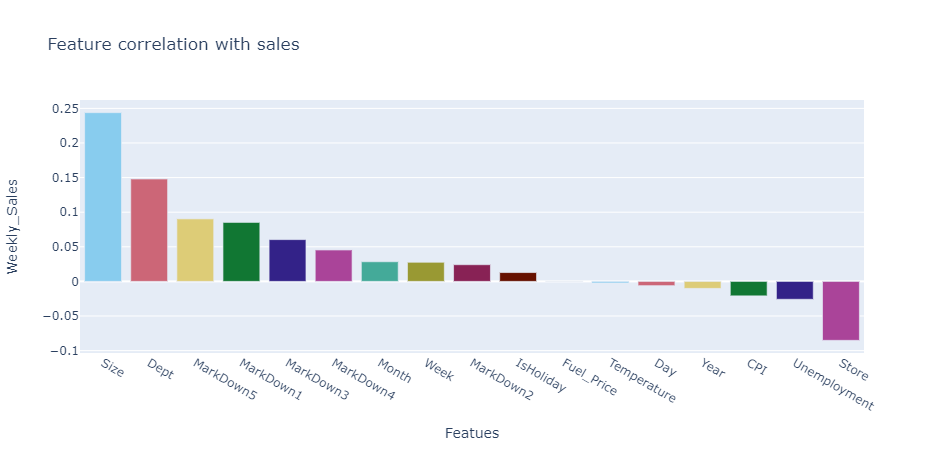

In [32]:
weekly_sales_corr = train_df.corr().iloc[2,:]
corr_df = pd.DataFrame(data = weekly_sales_corr, index = weekly_sales_corr.index ).sort_values (by = 'Weekly_Sales', ascending = False)
corr_df = corr_df.iloc[1:]
bar = px.bar(corr_df, x = corr_df.index, y = 'Weekly_Sales', color=corr_df.index, labels={'index':'Featues'},
             title='Feature correlation with sales',color_discrete_sequence=palette)
bar.update_traces(showlegend=False)

In [33]:
data_train = train_df.copy()
data_test = test_df.copy()

In [34]:
data_train['Days_to_Thansksgiving'] = (pd.to_datetime(train_df["Year"].astype(str)+"-11-24", format="%Y-%m-%d") - pd.to_datetime(train_df["Date"], format="%Y-%m-%d")).dt.days.astype(int)
data_train['Days_to_Christmas'] = (pd.to_datetime(train_df["Year"].astype(str)+"-12-24", format="%Y-%m-%d") - pd.to_datetime(train_df["Date"], format="%Y-%m-%d")).dt.days.astype(int)

In [35]:
data_test['Days_to_Thansksgiving'] = (pd.to_datetime(test_df["Year"].astype(str)+"-11-24", format="%Y-%m-%d") - pd.to_datetime(test_df["Date"], format="%Y-%m-%d")).dt.days.astype(int)
data_test['Days_to_Christmas'] = (pd.to_datetime(test_df["Year"].astype(str)+"-12-24", format="%Y-%m-%d") - pd.to_datetime(test_df["Date"], format="%Y-%m-%d")).dt.days.astype(int)

In [36]:
data_train['SuperBowlWeek'] = train_df['Week'].apply(lambda x: 1 if x == 6 else 0)
data_train['LaborDay'] = train_df['Week'].apply(lambda x: 1 if x == 36 else 0)
data_train['Tranksgiving'] = train_df['Week'].apply(lambda x: 1 if x == 47 else 0)
data_train['Christmas'] = train_df['Week'].apply(lambda x: 1 if x == 52 else 0)

In [37]:
data_test['SuperBowlWeek'] = test_df['Week'].apply(lambda x: 1 if x == 6 else 0)
data_test['LaborDay'] = test_df['Week'].apply(lambda x: 1 if x == 36 else 0)
data_test['Tranksgiving'] = test_df['Week'].apply(lambda x: 1 if x == 47 else 0)
data_test['Christmas'] = test_df['Week'].apply(lambda x: 1 if x == 52 else 0)

In [38]:
data_train['MarkdownsSum'] = train_df['MarkDown1'] + train_df['MarkDown2'] + train_df['MarkDown3'] + train_df['MarkDown4'] + train_df['MarkDown5'] 

In [39]:
data_test['MarkdownsSum'] = test_df['MarkDown1'] + test_df['MarkDown2'] + test_df['MarkDown3'] + test_df['MarkDown4'] + test_df['MarkDown5']

In [40]:
data_train.isna().sum()[data_train.isna().sum() > 0].sort_values(ascending=False)

MarkdownsSum    324514
MarkDown2       310322
MarkDown4       286603
MarkDown3       284479
MarkDown1       270889
MarkDown5       270138
dtype: int64

In [41]:
data_test.isna().sum()[data_test.isna().sum() > 0].sort_values(ascending=False)

CPI             38162
Unemployment    38162
MarkdownsSum    37457
MarkDown2       28627
MarkDown4       12888
MarkDown3        9829
MarkDown1         149
dtype: int64

In [42]:
data_train.fillna(0, inplace = True)

In [43]:
data_test['CPI'].fillna(data_test['CPI'].mean(), inplace = True)
data_test['Unemployment'].fillna(data_test['Unemployment'].mean(), inplace = True)

In [44]:
data_test.fillna(0, inplace = True)

In [45]:
data_train['IsHoliday'] = data_train['IsHoliday'].apply(lambda x: 1 if x == True else 0)
data_test['IsHoliday'] = data_test['IsHoliday'].apply(lambda x: 1 if x == True else 0)

In [46]:
data_train['Type'] = data_train['Type'].apply(lambda x: 1 if x == 'A' else (2 if x == 'B' else 3))
data_test['Type'] = data_test['Type'].apply(lambda x: 1 if x == 'A' else (2 if x == 'B' else 3))

In [47]:
features = [feature for feature in data_train.columns if feature not in ('Date','Weekly_Sales')]

In [48]:
X = data_train[features].copy()
y = data_train.Weekly_Sales.copy()

In [49]:
data_sample = data_train.copy().sample(frac=.25)
X_sample = data_sample[features].copy()
y_sample = data_sample.Weekly_Sales.copy()

In [50]:
X_train, X_valid, y_train, y_valid = model_selection.train_test_split(X_sample, y_sample, random_state=0, test_size=0.15)

In [51]:
feat_model = xgb.XGBRegressor(random_state=0).fit(X_train, y_train)

In [52]:
import eli5
from eli5.sklearn import PermutationImportance

perm = PermutationImportance(feat_model, random_state=1).fit(X_valid, y_valid)
features = eli5.show_weights(perm, top=len(X_train.columns), feature_names = X_valid.columns.tolist())

In [53]:
features_weights = eli5.show_weights(perm, top=len(X_train.columns), feature_names = X_valid.columns.tolist())
features_weights

Weight,Feature
1.6385 ± 0.0434,Dept
0.4526 ± 0.0149,Size
0.1252 ± 0.0049,Store
0.0539 ± 0.0031,CPI
0.0319 ± 0.0033,Week
0.0190 ± 0.0085,Tranksgiving
0.0112 ± 0.0007,Unemployment
0.0107 ± 0.0027,Day
0.0105 ± 0.0006,Type
0.0099 ± 0.0011,Days_to_Thansksgiving


In [54]:
f_importances = pd.Series(dict(zip(X_valid.columns.tolist(), perm.feature_importances_))).sort_values(ascending=False)
f_importances

Dept                     1.638479e+00
Size                     4.525909e-01
Store                    1.251668e-01
CPI                      5.392875e-02
Week                     3.185366e-02
Tranksgiving             1.898022e-02
Unemployment             1.115764e-02
Day                      1.073004e-02
Type                     1.049540e-02
Days_to_Thansksgiving    9.949120e-03
Temperature              6.463357e-03
Fuel_Price               2.203299e-03
MarkDown3                1.946084e-03
IsHoliday                1.648453e-03
MarkDown4                4.906437e-04
MarkDown5                4.895460e-04
MarkDown1                1.897279e-04
MarkDown2                1.617723e-04
SuperBowlWeek            1.355498e-05
Year                     1.119346e-07
LaborDay                 6.753665e-08
Days_to_Christmas        0.000000e+00
Christmas                0.000000e+00
Month                   -1.415881e-05
MarkdownsSum            -8.402062e-05
dtype: float64

In [55]:
weights = eli5.show_weights(perm, top=len(X_train.columns), feature_names=X_valid.columns.tolist())
result = pd.read_html(weights.data)[0]
result

,Weight,Feature
0,1.6385 ± 0.0434,Dept
1,0.4526 ± 0.0149,Size
2,0.1252 ± 0.0049,Store
3,0.0539 ± 0.0031,CPI
4,0.0319 ± 0.0033,Week
5,0.0190 ± 0.0085,Tranksgiving
6,0.0112 ± 0.0007,Unemployment
7,0.0107 ± 0.0027,Day
8,0.0105 ± 0.0006,Type
9,0.0099 ± 0.0011,Days_to_Thansksgiving


In [56]:
# Eval metric for the competition
def WMAE(dataset, real, predicted):
    weights = dataset.IsHoliday.apply(lambda x: 5 if x else 1)
    return np.round(np.sum(weights*abs(real-predicted))/(np.sum(weights)), 2)

In [57]:
models = {
          '    LGBM': lgb.LGBMRegressor(random_state = 0),
          ' XGBoost': xgb.XGBRegressor(random_state = 0, objective = 'reg:squarederror'),
          'Catboost': cb.CatBoostRegressor(random_state = 0, verbose=False),          
          '    HGBR': HistGradientBoostingRegressor(random_state = 0),
          ' ExtraTr': ensemble.ExtraTreesRegressor(bootstrap = True, random_state = 0),
          ' RandomF': ensemble.RandomForestRegressor(random_state = 0),
         }

In [58]:
def model_evaluation (name, model, models, X_train, y_train, X_valid, y_valid):
   
    rmses = []
    
    for i in range(len(models)):
    
        # Model fit
        model.fit(X_train, y_train)
        
        # Model predict
        y_preds = model.predict(X_valid)

        # RMSE
        rmse = np.sqrt(np.mean((y_valid - y_preds)**2))
        rmses.append(rmse)
        
    return np.mean(rmses)

In [59]:
for name, model in models.items():
    print(name + ' Valid RMSE {:.4f}'.format(model_evaluation(name, model, models,  X_train, y_train, X_valid, y_valid)) )

    LGBM Valid RMSE 6838.4359
 XGBoost Valid RMSE 5621.0998
Catboost Valid RMSE 5863.8432
    HGBR Valid RMSE 6865.5714
 ExtraTr Valid RMSE 4976.2972
 RandomF Valid RMSE 4256.5439


In [60]:
X_baseline = X[['Store','Dept','IsHoliday','Size','Week','Type','Year','Day']].copy()

In [61]:
X_train, X_valid, y_train, y_valid = model_selection.train_test_split(X_baseline, y, random_state=0, test_size=0.1)

In [62]:
RF = ensemble.RandomForestRegressor(n_estimators=100, max_depth=25, min_samples_split=3, min_samples_leaf=1)
RF.fit(X_train, y_train)

RandomForestRegressor(max_depth=25, min_samples_split=3)

In [63]:
test = data_test[['Store','Dept','IsHoliday','Size','Week','Type','Year','Day']].copy()
predict_rf = RF.predict(test)

In [64]:
sample_submission['Weekly_Sales'] = predict_rf
sample_submission.to_csv('submission.csv',index=False)